### 1. Se pide:

A partir del archivo "USA_Housing.csv", realizar la regresión no lineal entre cada columna numérica con la columna 'price' utilizando:

- Regresión polinómica no lineal con grados del 2 al 10. ¿El score se estanca a partir de cierto grado?

- Si no aumenta el score un poco significamente, es mejor no aumentar los grados y quedarte con el grado más bajo, si con el grado 2 da el mismo resultado que el grado 3, nos quedamos con el grado 2

In [5]:
import pandas as pd

df = pd.read_csv("../data/USA_Housing.csv")
df

,Avg. Area Income,Avg. Area House Age,Avg. Area Number of Rooms,Avg. Area Number of Bedrooms,Area Population,Price,Address
0,79545.458574,5.682861,7.009188,4.09,23086.800503,1.059034e+06,"208 Michael Ferry Apt. 674\r\nLaurabury, NE 37..."
1,79248.642455,6.002900,6.730821,3.09,40173.072174,1.505891e+06,"188 Johnson Views Suite 079\r\nLake Kathleen, ..."
2,61287.067179,5.865890,8.512727,5.13,36882.159400,1.058988e+06,"9127 Elizabeth Stravenue\r\nDanieltown, WI 064..."
3,63345.240046,7.188236,5.586729,3.26,34310.242831,1.260617e+06,USS Barnett\r\nFPO AP 44820
4,59982.197226,5.040555,7.839388,4.23,26354.109472,6.309435e+05,USNS Raymond\r\nFPO AE 09386
...,...,...,...,...,...,...,...
4995,60567.944140,7.830362,6.137356,3.46,22837.361035,1.060194e+06,USNS Williams\r\nFPO AP 30153-7653
4996,78491.275435,6.999135,6.576763,4.02,25616.115489,1.482618e+06,"PSC 9258, Box 8489\r\nAPO AA 42991-3352"
4997,63390.686886,7.250591,4.805081,2.13,33266.145490,1.030730e+06,"4215 Tracy Garden Suite 076\r\nJoshualand, VA ..."
4998,68001.331235,5.534388,7.130144,5.44,42625.620156,1.198657e+06,USS Wallace\r\nFPO AE 73316


In [2]:
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import PolynomialFeatures
from sklearn.linear_model import LinearRegression
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.metrics import r2_score, mean_absolute_error
import numpy as np

In [23]:
def reg_poly(column):
    X = np.array(df[column]).reshape(-1, 1)
    y = np.array(df["Price"]).reshape(-1, 1)
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=4)

    degree_min = 2
    degree_max = 10
    
    score = {}

    for degree in range(degree_min,degree_max+1):
        
        polinominal_model = PolynomialFeatures(degree) 
        X_poly = polinominal_model.fit_transform(X_train.reshape(-1, 1),y_train)

        print(X_poly)
        print(X_poly.shape)

        lin_reg_model = LinearRegression()
        lin_reg_model.fit(X_poly, y_train)
        y_pred = lin_reg_model.predict(X_poly)

        print("---------------------------------------------------------------------------")
        print("Score r2:", r2_score(y_train, y_pred))
        print("MAE:", mean_absolute_error(y_true=y_train, y_pred=y_pred))
        
        score[degree] = r2_score(y_train, y_pred)

        # Gráfico
        X_train_to_show, y_train_to_show = zip(*sorted(zip(X_train, y_train)))
        plt.scatter(X_train_to_show, y_train_to_show, color='b')
        X_train_to_show, y_pred = zip(*sorted(zip(X_train, y_pred)))
        plt.plot(X_train_to_show, y_pred, color='red')
        plt.title("Poninominal degree " + str(degree))
        plt.show()

    print(score)


### Avg. Area Income

[[1.00000000e+00 8.44398557e+04 7.13008924e+09]
 [1.00000000e+00 7.06893643e+04 4.99698623e+09]
 [1.00000000e+00 7.10689961e+04 5.05080221e+09]
 ...
 [1.00000000e+00 7.96877619e+04 6.35013939e+09]
 [1.00000000e+00 8.33476697e+04 6.94683404e+09]
 [1.00000000e+00 6.58461710e+04 4.33571824e+09]]
(4000, 3)
---------------------------------------------------------------------------
Score r2: 0.40010412821979635
MAE: 218711.87537119002


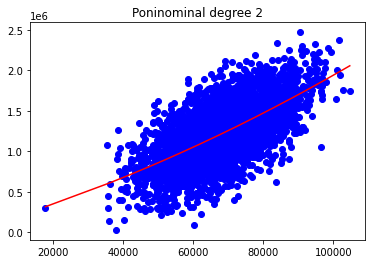

[[1.00000000e+00 8.44398557e+04 7.13008924e+09 6.02063707e+14]
 [1.00000000e+00 7.06893643e+04 4.99698623e+09 3.53233780e+14]
 [1.00000000e+00 7.10689961e+04 5.05080221e+09 3.58955443e+14]
 ...
 [1.00000000e+00 7.96877619e+04 6.35013939e+09 5.06028396e+14]
 [1.00000000e+00 8.33476697e+04 6.94683404e+09 5.79002429e+14]
 [1.00000000e+00 6.58461710e+04 4.33571824e+09 2.85490445e+14]]
(4000, 4)
---------------------------------------------------------------------------
Score r2: 0.4001465896729065
MAE: 218723.0956419132


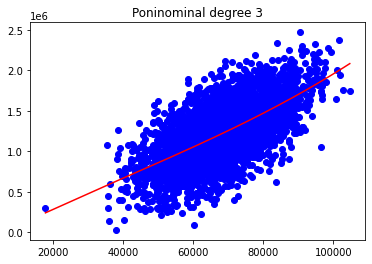

[[1.00000000e+00 8.44398557e+04 7.13008924e+09 6.02063707e+14
  5.08381726e+19]
 [1.00000000e+00 7.06893643e+04 4.99698623e+09 3.53233780e+14
  2.49698714e+19]
 [1.00000000e+00 7.10689961e+04 5.05080221e+09 3.58955443e+14
  2.55106030e+19]
 ...
 [1.00000000e+00 7.96877619e+04 6.35013939e+09 5.06028396e+14
  4.03242703e+19]
 [1.00000000e+00 8.33476697e+04 6.94683404e+09 5.79002429e+14
  4.82585032e+19]
 [1.00000000e+00 6.58461710e+04 4.33571824e+09 2.85490445e+14
  1.87984527e+19]]
(4000, 5)
---------------------------------------------------------------------------
Score r2: 0.40016517519243455
MAE: 218714.58031179494


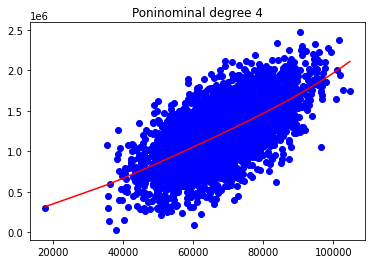

[[1.00000000e+00 8.44398557e+04 7.13008924e+09 6.02063707e+14
  5.08381726e+19 4.29276796e+24]
 [1.00000000e+00 7.06893643e+04 4.99698623e+09 3.53233780e+14
  2.49698714e+19 1.76510434e+24]
 [1.00000000e+00 7.10689961e+04 5.05080221e+09 3.58955443e+14
  2.55106030e+19 1.81301294e+24]
 ...
 [1.00000000e+00 7.96877619e+04 6.35013939e+09 5.06028396e+14
  4.03242703e+19 3.21335085e+24]
 [1.00000000e+00 8.33476697e+04 6.94683404e+09 5.79002429e+14
  4.82585032e+19 4.02223379e+24]
 [1.00000000e+00 6.58461710e+04 4.33571824e+09 2.85490445e+14
  1.87984527e+19 1.23780613e+24]]
(4000, 6)
---------------------------------------------------------------------------
Score r2: 0.4000807662730449
MAE: 218758.78755199135


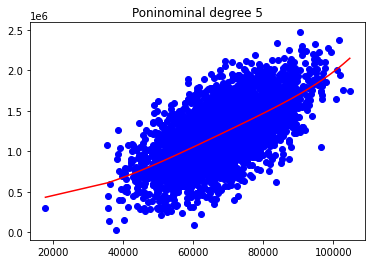

[[1.00000000e+00 8.44398557e+04 7.13008924e+09 ... 5.08381726e+19
  4.29276796e+24 3.62480707e+29]
 [1.00000000e+00 7.06893643e+04 4.99698623e+09 ... 2.49698714e+19
  1.76510434e+24 1.24774104e+29]
 [1.00000000e+00 7.10689961e+04 5.05080221e+09 ... 2.55106030e+19
  1.81301294e+24 1.28849010e+29]
 ...
 [1.00000000e+00 7.96877619e+04 6.35013939e+09 ... 4.03242703e+19
  3.21335085e+24 2.56064737e+29]
 [1.00000000e+00 8.33476697e+04 6.94683404e+09 ... 4.82585032e+19
  4.02223379e+24 3.35243813e+29]
 [1.00000000e+00 6.58461710e+04 4.33571824e+09 ... 1.87984527e+19
  1.23780613e+24 8.15047941e+28]]
(4000, 7)
---------------------------------------------------------------------------
Score r2: 0.3997202654605564
MAE: 218835.87753451537


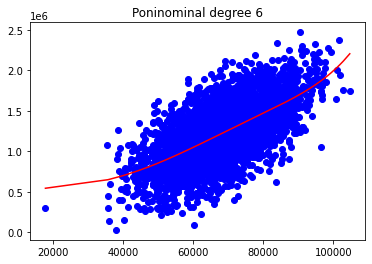

[[1.00000000e+00 8.44398557e+04 7.13008924e+09 ... 4.29276796e+24
  3.62480707e+29 3.06078186e+34]
 [1.00000000e+00 7.06893643e+04 4.99698623e+09 ... 1.76510434e+24
  1.24774104e+29 8.82020206e+33]
 [1.00000000e+00 7.10689961e+04 5.05080221e+09 ... 1.81301294e+24
  1.28849010e+29 9.15716977e+33]
 ...
 [1.00000000e+00 7.96877619e+04 6.35013939e+09 ... 3.21335085e+24
  2.56064737e+29 2.04052258e+34]
 [1.00000000e+00 8.33476697e+04 6.94683404e+09 ... 4.02223379e+24
  3.35243813e+29 2.79417906e+34]
 [1.00000000e+00 6.58461710e+04 4.33571824e+09 ... 1.23780613e+24
  8.15047941e+28 5.36677861e+33]]
(4000, 8)
---------------------------------------------------------------------------
Score r2: 0.39882187338689723
MAE: 218966.72001079065


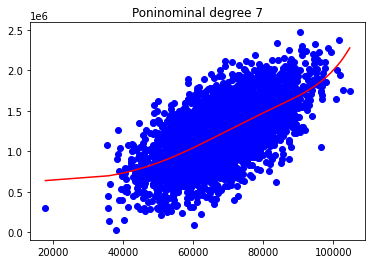

[[1.00000000e+00 8.44398557e+04 7.13008924e+09 ... 3.62480707e+29
  3.06078186e+34 2.58451979e+39]
 [1.00000000e+00 7.06893643e+04 4.99698623e+09 ... 1.24774104e+29
  8.82020206e+33 6.23494477e+38]
 [1.00000000e+00 7.10689961e+04 5.05080221e+09 ... 1.28849010e+29
  9.15716977e+33 6.50790863e+38]
 ...
 [1.00000000e+00 7.96877619e+04 6.35013939e+09 ... 2.56064737e+29
  2.04052258e+34 1.62604677e+39]
 [1.00000000e+00 8.33476697e+04 6.94683404e+09 ... 3.35243813e+29
  2.79417906e+34 2.32888313e+39]
 [1.00000000e+00 6.58461710e+04 4.33571824e+09 ... 8.15047941e+28
  5.36677861e+33 3.53381822e+38]]
(4000, 9)
---------------------------------------------------------------------------
Score r2: 0.39707187660037746
MAE: 219219.2751438219


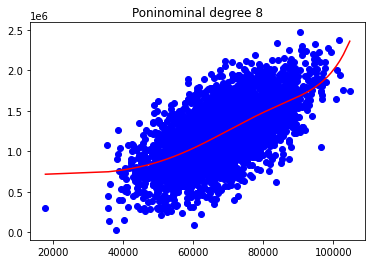

[[1.00000000e+00 8.44398557e+04 7.13008924e+09 ... 3.06078186e+34
  2.58451979e+39 2.18236478e+44]
 [1.00000000e+00 7.06893643e+04 4.99698623e+09 ... 8.82020206e+33
  6.23494477e+38 4.40744283e+43]
 [1.00000000e+00 7.10689961e+04 5.05080221e+09 ... 9.15716977e+33
  6.50790863e+38 4.62510533e+43]
 ...
 [1.00000000e+00 7.96877619e+04 6.35013939e+09 ... 2.04052258e+34
  1.62604677e+39 1.29576028e+44]
 [1.00000000e+00 8.33476697e+04 6.94683404e+09 ... 2.79417906e+34
  2.32888313e+39 1.94106982e+44]
 [1.00000000e+00 6.58461710e+04 4.33571824e+09 ... 5.36677861e+33
  3.53381822e+38 2.32688399e+43]]
(4000, 10)
---------------------------------------------------------------------------
Score r2: 0.3941810423616926
MAE: 219665.86112355482


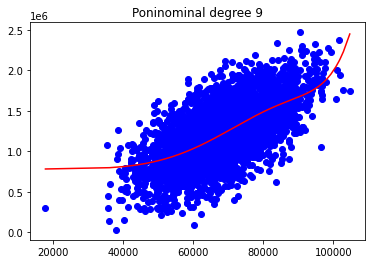

[[1.00000000e+00 8.44398557e+04 7.13008924e+09 ... 2.58451979e+39
  2.18236478e+44 1.84278567e+49]
 [1.00000000e+00 7.06893643e+04 4.99698623e+09 ... 6.23494477e+38
  4.40744283e+43 3.11559332e+48]
 [1.00000000e+00 7.10689961e+04 5.05080221e+09 ... 6.50790863e+38
  4.62510533e+43 3.28701593e+48]
 ...
 [1.00000000e+00 7.96877619e+04 6.35013939e+09 ... 1.62604677e+39
  1.29576028e+44 1.03256237e+49]
 [1.00000000e+00 8.33476697e+04 6.94683404e+09 ... 2.32888313e+39
  1.94106982e+44 1.61783646e+49]
 [1.00000000e+00 6.58461710e+04 4.33571824e+09 ... 3.53381822e+38
  2.32688399e+43 1.53216401e+48]]
(4000, 11)
---------------------------------------------------------------------------
Score r2: 0.3899401899752222
MAE: 220310.70487960012


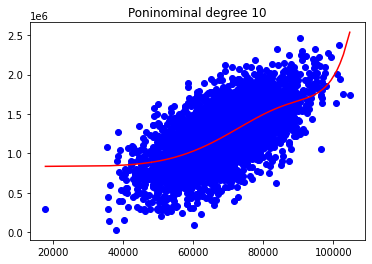

{2: 0.40010412821979635, 3: 0.4001465896729065, 4: 0.40016517519243455, 5: 0.4000807662730449, 6: 0.3997202654605564, 7: 0.39882187338689723, 8: 0.39707187660037746, 9: 0.3941810423616926, 10: 0.3899401899752222}


In [24]:
reg_poly("Avg. Area Income")

In [ ]:
# Se estanca a partir del grado 5

### Avg. Area House Age

[[ 1.          4.31397784 18.61040481]
 [ 1.          5.86524639 34.40111516]
 [ 1.          4.74689645 22.53302589]
 ...
 [ 1.          6.01036768 36.12451969]
 [ 1.          5.46815843 29.90075658]
 [ 1.          6.38537365 40.77299661]]
(4000, 3)
---------------------------------------------------------------------------
Score r2: 0.20333367005189218
MAE: 251433.06930808022


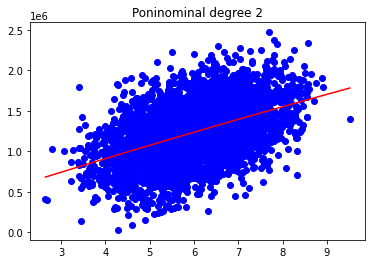

[[  1.           4.31397784  18.61040481  80.28487397]
 [  1.           5.86524639  34.40111516 201.77101637]
 [  1.           4.74689645  22.53302589 106.96194055]
 ...
 [  1.           6.01036768  36.12451969 217.12164569]
 [  1.           5.46815843  29.90075658 163.5020741 ]
 [  1.           6.38537365  40.77299661 260.35081806]]
(4000, 4)
---------------------------------------------------------------------------
Score r2: 0.20359095068025423
MAE: 251395.6118667414


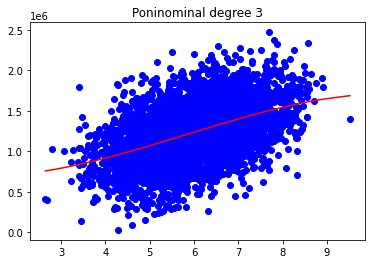

[[1.00000000e+00 4.31397784e+00 1.86104048e+01 8.02848740e+01
  3.46347167e+02]
 [1.00000000e+00 5.86524639e+00 3.44011152e+01 2.01771016e+02
  1.18343672e+03]
 [1.00000000e+00 4.74689645e+00 2.25330259e+01 1.06961941e+02
  5.07737256e+02]
 ...
 [1.00000000e+00 6.01036768e+00 3.61245197e+01 2.17121646e+02
  1.30498092e+03]
 [1.00000000e+00 5.46815843e+00 2.99007566e+01 1.63502074e+02
  8.94055244e+02]
 [1.00000000e+00 6.38537365e+00 4.07729966e+01 2.60350818e+02
  1.66243725e+03]]
(4000, 5)
---------------------------------------------------------------------------
Score r2: 0.20360653137905094
MAE: 251392.1930157066


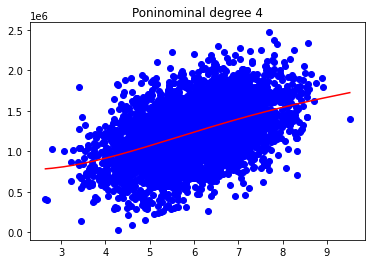

[[1.00000000e+00 4.31397784e+00 1.86104048e+01 8.02848740e+01
  3.46347167e+02 1.49413400e+03]
 [1.00000000e+00 5.86524639e+00 3.44011152e+01 2.01771016e+02
  1.18343672e+03 6.94114797e+03]
 [1.00000000e+00 4.74689645e+00 2.25330259e+01 1.06961941e+02
  5.07737256e+02 2.41017618e+03]
 ...
 [1.00000000e+00 6.01036768e+00 3.61245197e+01 2.17121646e+02
  1.30498092e+03 7.84341516e+03]
 [1.00000000e+00 5.46815843e+00 2.99007566e+01 1.63502074e+02
  8.94055244e+02 4.88883572e+03]
 [1.00000000e+00 6.38537365e+00 4.07729966e+01 2.60350818e+02
  1.66243725e+03 1.06152830e+04]]
(4000, 6)
---------------------------------------------------------------------------
Score r2: 0.2039272694085107
MAE: 251292.10025129598


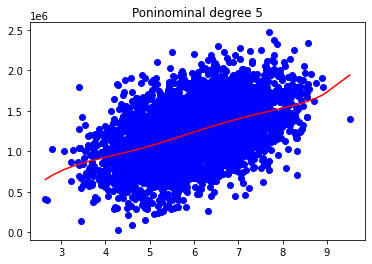

[[1.00000000e+00 4.31397784e+00 1.86104048e+01 ... 3.46347167e+02
  1.49413400e+03 6.44566099e+03]
 [1.00000000e+00 5.86524639e+00 3.44011152e+01 ... 1.18343672e+03
  6.94114797e+03 4.07115430e+04]
 [1.00000000e+00 4.74689645e+00 2.25330259e+01 ... 5.07737256e+02
  2.41017618e+03 1.14408567e+04]
 ...
 [1.00000000e+00 6.01036768e+00 3.61245197e+01 ... 1.30498092e+03
  7.84341516e+03 4.71418090e+04]
 [1.00000000e+00 5.46815843e+00 2.99007566e+01 ... 8.94055244e+02
  4.88883572e+03 2.67329282e+04]
 [1.00000000e+00 6.38537365e+00 4.07729966e+01 ... 1.66243725e+03
  1.06152830e+04 6.77825485e+04]]
(4000, 7)
---------------------------------------------------------------------------
Score r2: 0.20455542635019763
MAE: 251183.49833923843


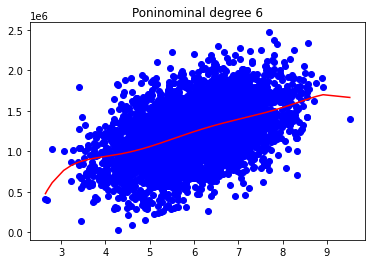

[[1.00000000e+00 4.31397784e+00 1.86104048e+01 ... 1.49413400e+03
  6.44566099e+03 2.78064387e+04]
 [1.00000000e+00 5.86524639e+00 3.44011152e+01 ... 6.94114797e+03
  4.07115430e+04 2.38783231e+05]
 [1.00000000e+00 4.74689645e+00 2.25330259e+01 ... 2.41017618e+03
  1.14408567e+04 5.43085622e+04]
 ...
 [1.00000000e+00 6.01036768e+00 3.61245197e+01 ... 7.84341516e+03
  4.71418090e+04 2.83339606e+05]
 [1.00000000e+00 5.46815843e+00 2.99007566e+01 ... 4.88883572e+03
  2.67329282e+04 1.46179887e+05]
 [1.00000000e+00 6.38537365e+00 4.07729966e+01 ... 1.06152830e+04
  6.77825485e+04 4.32816899e+05]]
(4000, 8)
---------------------------------------------------------------------------
Score r2: 0.2054524236282821
MAE: 250876.60242086265


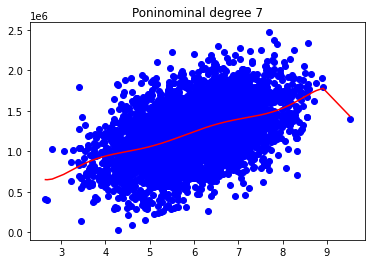

[[1.00000000e+00 4.31397784e+00 1.86104048e+01 ... 6.44566099e+03
  2.78064387e+04 1.19956360e+05]
 [1.00000000e+00 5.86524639e+00 3.44011152e+01 ... 4.07115430e+04
  2.38783231e+05 1.40052248e+06]
 [1.00000000e+00 4.74689645e+00 2.25330259e+01 ... 1.14408567e+04
  5.43085622e+04 2.57797121e+05]
 ...
 [1.00000000e+00 6.01036768e+00 3.61245197e+01 ... 4.71418090e+04
  2.83339606e+05 1.70297521e+06]
 [1.00000000e+00 5.46815843e+00 2.99007566e+01 ... 2.67329282e+04
  1.46179887e+05 7.99334780e+05]
 [1.00000000e+00 6.38537365e+00 4.07729966e+01 ... 6.77825485e+04
  4.32816899e+05 2.76369762e+06]]
(4000, 9)
---------------------------------------------------------------------------
Score r2: 0.20562143987319192
MAE: 250772.860877974


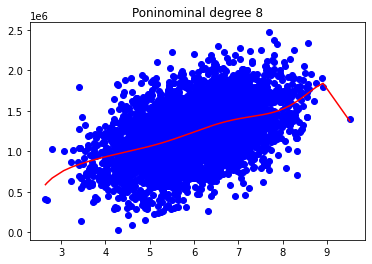

[[1.00000000e+00 4.31397784e+00 1.86104048e+01 ... 2.78064387e+04
  1.19956360e+05 5.17489080e+05]
 [1.00000000e+00 5.86524639e+00 3.44011152e+01 ... 2.38783231e+05
  1.40052248e+06 8.21440942e+06]
 [1.00000000e+00 4.74689645e+00 2.25330259e+01 ... 5.43085622e+04
  2.57797121e+05 1.22373624e+06]
 ...
 [1.00000000e+00 6.01036768e+00 3.61245197e+01 ... 2.83339606e+05
  1.70297521e+06 1.02355072e+07]
 [1.00000000e+00 5.46815843e+00 2.99007566e+01 ... 1.46179887e+05
  7.99334780e+05 4.37088921e+06]
 [1.00000000e+00 6.38537365e+00 4.07729966e+01 ... 4.32816899e+05
  2.76369762e+06 1.76472419e+07]]
(4000, 10)
---------------------------------------------------------------------------
Score r2: 0.20653162924558188
MAE: 250625.29065898788


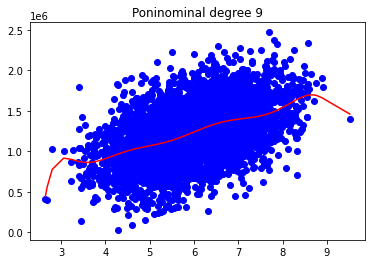

[[1.00000000e+00 4.31397784e+00 1.86104048e+01 ... 1.19956360e+05
  5.17489080e+05 2.23243642e+06]
 [1.00000000e+00 5.86524639e+00 3.44011152e+01 ... 1.40052248e+06
  8.21440942e+06 4.81795352e+07]
 [1.00000000e+00 4.74689645e+00 2.25330259e+01 ... 2.57797121e+05
  1.22373624e+06 5.80894920e+06]
 ...
 [1.00000000e+00 6.01036768e+00 3.61245197e+01 ... 1.70297521e+06
  1.02355072e+07 6.15191614e+07]
 [1.00000000e+00 5.46815843e+00 2.99007566e+01 ... 7.99334780e+05
  4.37088921e+06 2.39007147e+07]
 [1.00000000e+00 6.38537365e+00 4.07729966e+01 ... 2.76369762e+06
  1.76472419e+07 1.12684234e+08]]
(4000, 11)
---------------------------------------------------------------------------
Score r2: 0.20730859308018457
MAE: 250511.97838523038


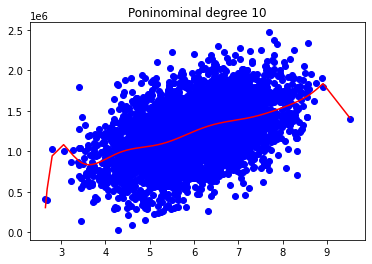

{2: 0.20333367005189218, 3: 0.20359095068025423, 4: 0.20360653137905094, 5: 0.2039272694085107, 6: 0.20455542635019763, 7: 0.2054524236282821, 8: 0.20562143987319192, 9: 0.20653162924558188, 10: 0.20730859308018457}


In [26]:
reg_poly("Avg. Area House Age")

In [ ]:
# Aquí no se estanca en estos grados, mejora el score

### Avg. Area Number of Rooms

[[ 1.          7.6987646  59.27097642]
 [ 1.          6.46290046 41.76908242]
 [ 1.          9.38791258 88.13290263]
 ...
 [ 1.          7.33739391 53.83734938]
 [ 1.          5.47525265 29.97839162]
 [ 1.          6.8041309  46.29619735]]
(4000, 3)
---------------------------------------------------------------------------
Score r2: 0.10655007499559999
MAE: 266731.9946707217


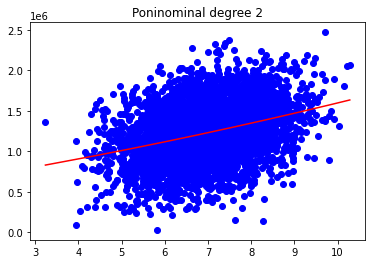

[[  1.           7.6987646   59.27097642 456.31329526]
 [  1.           6.46290046  41.76908242 269.94942215]
 [  1.           9.38791258  88.13290263 827.38398536]
 ...
 [  1.           7.33739391  53.83734938 395.02583941]
 [  1.           5.47525265  29.97839162 164.13926826]
 [  1.           6.8041309   46.29619735 315.00538712]]
(4000, 4)
---------------------------------------------------------------------------
Score r2: 0.10681023632189901
MAE: 266739.4405996386


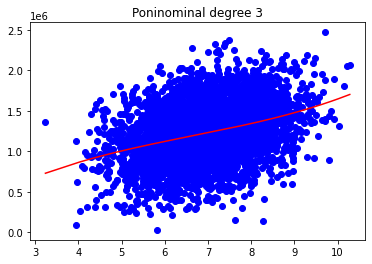

[[1.00000000e+00 7.69876460e+00 5.92709764e+01 4.56313295e+02
  3.51304865e+03]
 [1.00000000e+00 6.46290046e+00 4.17690824e+01 2.69949422e+02
  1.74465625e+03]
 [1.00000000e+00 9.38791258e+00 8.81329026e+01 8.27383985e+02
  7.76740853e+03]
 ...
 [1.00000000e+00 7.33739391e+00 5.38373494e+01 3.95025839e+02
  2.89846019e+03]
 [1.00000000e+00 5.47525265e+00 2.99783916e+01 1.64139268e+02
  8.98703964e+02]
 [1.00000000e+00 6.80413090e+00 4.62961974e+01 3.15005387e+02
  2.14333789e+03]]
(4000, 5)
---------------------------------------------------------------------------
Score r2: 0.1073351216087799
MAE: 266629.63575962104


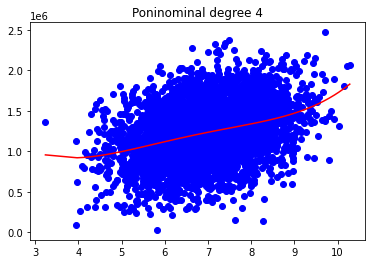

[[1.00000000e+00 7.69876460e+00 5.92709764e+01 4.56313295e+02
  3.51304865e+03 2.70461346e+04]
 [1.00000000e+00 6.46290046e+00 4.17690824e+01 2.69949422e+02
  1.74465625e+03 1.12755397e+04]
 [1.00000000e+00 9.38791258e+00 8.81329026e+01 8.27383985e+02
  7.76740853e+03 7.29197522e+04]
 ...
 [1.00000000e+00 7.33739391e+00 5.38373494e+01 3.95025839e+02
  2.89846019e+03 2.12671441e+04]
 [1.00000000e+00 5.47525265e+00 2.99783916e+01 1.64139268e+02
  8.98703964e+02 4.92063126e+03]
 [1.00000000e+00 6.80413090e+00 4.62961974e+01 3.15005387e+02
  2.14333789e+03 1.45835516e+04]]
(4000, 6)
---------------------------------------------------------------------------
Score r2: 0.10735474092962927
MAE: 266634.3191385028


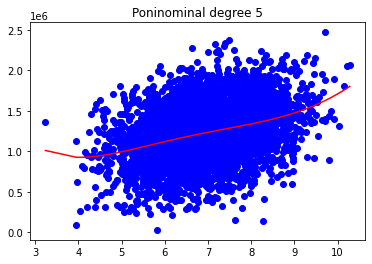

[[1.00000000e+00 7.69876460e+00 5.92709764e+01 ... 3.51304865e+03
  2.70461346e+04 2.08221823e+05]
 [1.00000000e+00 6.46290046e+00 4.17690824e+01 ... 1.74465625e+03
  1.12755397e+04 7.28726905e+04]
 [1.00000000e+00 9.38791258e+00 8.81329026e+01 ... 7.76740853e+03
  7.29197522e+04 6.84564259e+05]
 ...
 [1.00000000e+00 7.33739391e+00 5.38373494e+01 ... 2.89846019e+03
  2.12671441e+04 1.56045414e+05]
 [1.00000000e+00 5.47525265e+00 2.99783916e+01 ... 8.98703964e+02
  4.92063126e+03 2.69416994e+04]
 [1.00000000e+00 6.80413090e+00 4.62961974e+01 ... 2.14333789e+03
  1.45835516e+04 9.92283939e+04]]
(4000, 7)
---------------------------------------------------------------------------
Score r2: 0.10751628211556785
MAE: 266597.82554191165


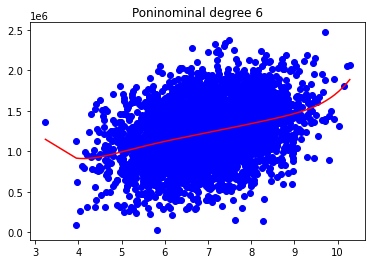

[[1.00000000e+00 7.69876460e+00 5.92709764e+01 ... 2.70461346e+04
  2.08221823e+05 1.60305080e+06]
 [1.00000000e+00 6.46290046e+00 4.17690824e+01 ... 1.12755397e+04
  7.28726905e+04 4.70968945e+05]
 [1.00000000e+00 9.38791258e+00 8.81329026e+01 ... 7.29197522e+04
  6.84564259e+05 6.42662942e+06]
 ...
 [1.00000000e+00 7.33739391e+00 5.38373494e+01 ... 2.12671441e+04
  1.56045414e+05 1.14496667e+06]
 [1.00000000e+00 5.47525265e+00 2.99783916e+01 ... 4.92063126e+03
  2.69416994e+04 1.47512611e+05]
 [1.00000000e+00 6.80413090e+00 4.62961974e+01 ... 1.45835516e+04
  9.92283939e+04 6.75162982e+05]]
(4000, 8)
---------------------------------------------------------------------------
Score r2: 0.10751805877707354
MAE: 266601.5727893894


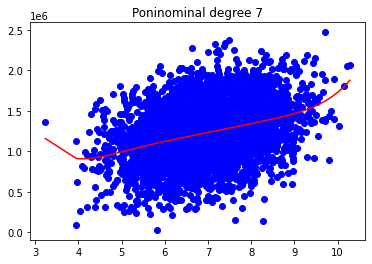

[[1.00000000e+00 7.69876460e+00 5.92709764e+01 ... 2.08221823e+05
  1.60305080e+06 1.23415108e+07]
 [1.00000000e+00 6.46290046e+00 4.17690824e+01 ... 7.28726905e+04
  4.70968945e+05 3.04382542e+06]
 [1.00000000e+00 9.38791258e+00 8.81329026e+01 ... 6.84564259e+05
  6.42662942e+06 6.03326352e+07]
 ...
 [1.00000000e+00 7.33739391e+00 5.38373494e+01 ... 1.56045414e+05
  1.14496667e+06 8.40107146e+06]
 [1.00000000e+00 5.47525265e+00 2.99783916e+01 ... 2.69416994e+04
  1.47512611e+05 8.07668815e+05]
 [1.00000000e+00 6.80413090e+00 4.62961974e+01 ... 9.92283939e+04
  6.75162982e+05 4.59389731e+06]]
(4000, 9)
---------------------------------------------------------------------------
Score r2: 0.10810080326440163
MAE: 266419.456844907


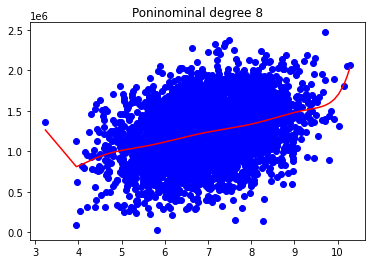

[[1.00000000e+00 7.69876460e+00 5.92709764e+01 ... 1.60305080e+06
  1.23415108e+07 9.50143864e+07]
 [1.00000000e+00 6.46290046e+00 4.17690824e+01 ... 4.70968945e+05
  3.04382542e+06 1.96719407e+07]
 [1.00000000e+00 9.38791258e+00 8.81329026e+01 ... 6.42662942e+06
  6.03326352e+07 5.66397505e+08]
 ...
 [1.00000000e+00 7.33739391e+00 5.38373494e+01 ... 1.14496667e+06
  8.40107146e+06 6.16419706e+07]
 [1.00000000e+00 5.47525265e+00 2.99783916e+01 ... 1.47512611e+05
  8.07668815e+05 4.42219082e+06]
 [1.00000000e+00 6.80413090e+00 4.62961974e+01 ... 6.75162982e+05
  4.59389731e+06 3.12574786e+07]]
(4000, 10)
---------------------------------------------------------------------------
Score r2: 0.10865954745390982
MAE: 266410.9841485477


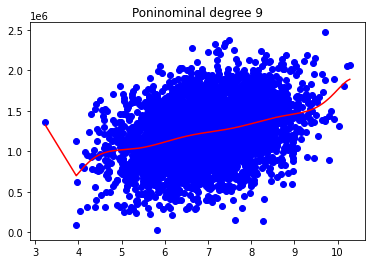

[[1.00000000e+00 7.69876460e+00 5.92709764e+01 ... 1.23415108e+07
  9.50143864e+07 7.31493395e+08]
 [1.00000000e+00 6.46290046e+00 4.17690824e+01 ... 3.04382542e+06
  1.96719407e+07 1.27137795e+08]
 [1.00000000e+00 9.38791258e+00 8.81329026e+01 ... 6.03326352e+07
  5.66397505e+08 5.31729026e+09]
 ...
 [1.00000000e+00 7.33739391e+00 5.38373494e+01 ... 8.40107146e+06
  6.16419706e+07 4.52291419e+08]
 [1.00000000e+00 5.47525265e+00 2.99783916e+01 ... 8.07668815e+05
  4.42219082e+06 2.42126120e+07]
 [1.00000000e+00 6.80413090e+00 4.62961974e+01 ... 4.59389731e+06
  3.12574786e+07 2.12679976e+08]]
(4000, 11)
---------------------------------------------------------------------------
Score r2: 0.10965464814657111
MAE: 266266.9728418121


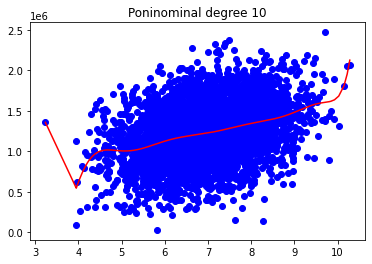

{2: 0.10655007499559999, 3: 0.10681023632189901, 4: 0.1073351216087799, 5: 0.10735474092962927, 6: 0.10751628211556785, 7: 0.10751805877707354, 8: 0.10810080326440163, 9: 0.10865954745390982, 10: 0.10965464814657111}


In [28]:
reg_poly("Avg. Area Number of Rooms")

In [ ]:
# Aquí no se estanca, mejora el score

### Avg. Area Number of Bedrooms

[[ 1.      4.48   20.0704]
 [ 1.      3.29   10.8241]
 [ 1.      6.2    38.44  ]
 ...
 [ 1.      6.09   37.0881]
 [ 1.      3.14    9.8596]
 [ 1.      3.18   10.1124]]
(4000, 3)
---------------------------------------------------------------------------
Score r2: 0.02597361841653567
MAE: 278630.9593957094


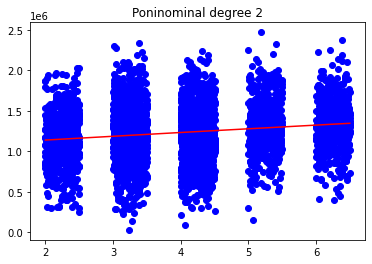

[[  1.         4.48      20.0704    89.915392]
 [  1.         3.29      10.8241    35.611289]
 [  1.         6.2       38.44     238.328   ]
 ...
 [  1.         6.09      37.0881   225.866529]
 [  1.         3.14       9.8596    30.959144]
 [  1.         3.18      10.1124    32.157432]]
(4000, 4)
---------------------------------------------------------------------------
Score r2: 0.026117860084385325
MAE: 278582.97554657114


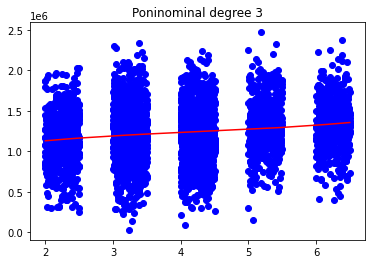

[[1.00000000e+00 4.48000000e+00 2.00704000e+01 8.99153920e+01
  4.02820956e+02]
 [1.00000000e+00 3.29000000e+00 1.08241000e+01 3.56112890e+01
  1.17161141e+02]
 [1.00000000e+00 6.20000000e+00 3.84400000e+01 2.38328000e+02
  1.47763360e+03]
 ...
 [1.00000000e+00 6.09000000e+00 3.70881000e+01 2.25866529e+02
  1.37552716e+03]
 [1.00000000e+00 3.14000000e+00 9.85960000e+00 3.09591440e+01
  9.72117122e+01]
 [1.00000000e+00 3.18000000e+00 1.01124000e+01 3.21574320e+01
  1.02260634e+02]]
(4000, 5)
---------------------------------------------------------------------------
Score r2: 0.030397316436166277
MAE: 277894.1522962337


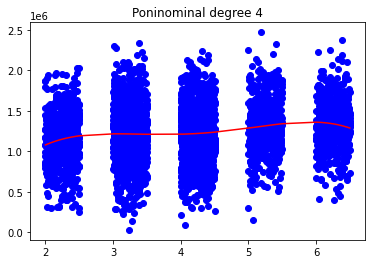

[[1.00000000e+00 4.48000000e+00 2.00704000e+01 8.99153920e+01
  4.02820956e+02 1.80463788e+03]
 [1.00000000e+00 3.29000000e+00 1.08241000e+01 3.56112890e+01
  1.17161141e+02 3.85460153e+02]
 [1.00000000e+00 6.20000000e+00 3.84400000e+01 2.38328000e+02
  1.47763360e+03 9.16132832e+03]
 ...
 [1.00000000e+00 6.09000000e+00 3.70881000e+01 2.25866529e+02
  1.37552716e+03 8.37696041e+03]
 [1.00000000e+00 3.14000000e+00 9.85960000e+00 3.09591440e+01
  9.72117122e+01 3.05244776e+02]
 [1.00000000e+00 3.18000000e+00 1.01124000e+01 3.21574320e+01
  1.02260634e+02 3.25188815e+02]]
(4000, 6)
---------------------------------------------------------------------------
Score r2: 0.03053608633906546
MAE: 277892.33928683266


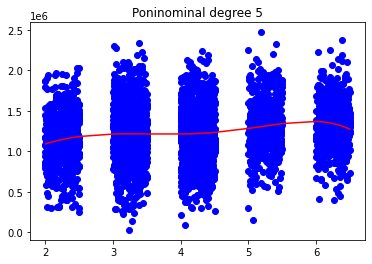

[[1.00000000e+00 4.48000000e+00 2.00704000e+01 ... 4.02820956e+02
  1.80463788e+03 8.08477772e+03]
 [1.00000000e+00 3.29000000e+00 1.08241000e+01 ... 1.17161141e+02
  3.85460153e+02 1.26816390e+03]
 [1.00000000e+00 6.20000000e+00 3.84400000e+01 ... 1.47763360e+03
  9.16132832e+03 5.68002356e+04]
 ...
 [1.00000000e+00 6.09000000e+00 3.70881000e+01 ... 1.37552716e+03
  8.37696041e+03 5.10156889e+04]
 [1.00000000e+00 3.14000000e+00 9.85960000e+00 ... 9.72117122e+01
  3.05244776e+02 9.58468597e+02]
 [1.00000000e+00 3.18000000e+00 1.01124000e+01 ... 1.02260634e+02
  3.25188815e+02 1.03410043e+03]]
(4000, 7)
---------------------------------------------------------------------------
Score r2: 0.031594883741954294
MAE: 277727.0723609147


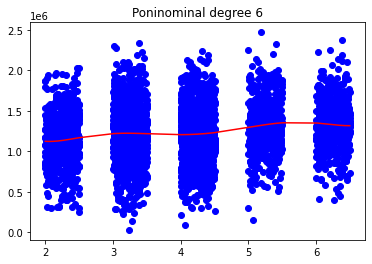

[[1.00000000e+00 4.48000000e+00 2.00704000e+01 ... 1.80463788e+03
  8.08477772e+03 3.62198042e+04]
 [1.00000000e+00 3.29000000e+00 1.08241000e+01 ... 3.85460153e+02
  1.26816390e+03 4.17225924e+03]
 [1.00000000e+00 6.20000000e+00 3.84400000e+01 ... 9.16132832e+03
  5.68002356e+04 3.52161461e+05]
 ...
 [1.00000000e+00 6.09000000e+00 3.70881000e+01 ... 8.37696041e+03
  5.10156889e+04 3.10685546e+05]
 [1.00000000e+00 3.14000000e+00 9.85960000e+00 ... 3.05244776e+02
  9.58468597e+02 3.00959140e+03]
 [1.00000000e+00 3.18000000e+00 1.01124000e+01 ... 3.25188815e+02
  1.03410043e+03 3.28843938e+03]]
(4000, 8)
---------------------------------------------------------------------------
Score r2: 0.031635432166517985
MAE: 277699.688222984


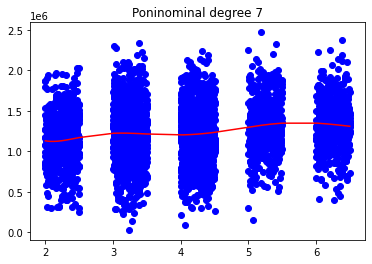

[[1.00000000e+00 4.48000000e+00 2.00704000e+01 ... 8.08477772e+03
  3.62198042e+04 1.62264723e+05]
 [1.00000000e+00 3.29000000e+00 1.08241000e+01 ... 1.26816390e+03
  4.17225924e+03 1.37267329e+04]
 [1.00000000e+00 6.20000000e+00 3.84400000e+01 ... 5.68002356e+04
  3.52161461e+05 2.18340106e+06]
 ...
 [1.00000000e+00 6.09000000e+00 3.70881000e+01 ... 5.10156889e+04
  3.10685546e+05 1.89207497e+06]
 [1.00000000e+00 3.14000000e+00 9.85960000e+00 ... 9.58468597e+02
  3.00959140e+03 9.45011698e+03]
 [1.00000000e+00 3.18000000e+00 1.01124000e+01 ... 1.03410043e+03
  3.28843938e+03 1.04572372e+04]]
(4000, 9)
---------------------------------------------------------------------------
Score r2: 0.03167425498019283
MAE: 277695.0805268979


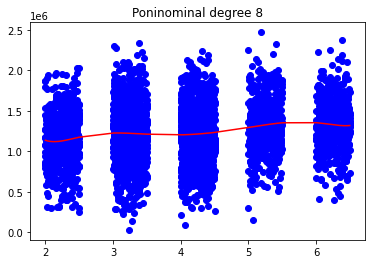

[[1.00000000e+00 4.48000000e+00 2.00704000e+01 ... 3.62198042e+04
  1.62264723e+05 7.26945958e+05]
 [1.00000000e+00 3.29000000e+00 1.08241000e+01 ... 4.17225924e+03
  1.37267329e+04 4.51609513e+04]
 [1.00000000e+00 6.20000000e+00 3.84400000e+01 ... 3.52161461e+05
  2.18340106e+06 1.35370865e+07]
 ...
 [1.00000000e+00 6.09000000e+00 3.70881000e+01 ... 3.10685546e+05
  1.89207497e+06 1.15227366e+07]
 [1.00000000e+00 3.14000000e+00 9.85960000e+00 ... 3.00959140e+03
  9.45011698e+03 2.96733673e+04]
 [1.00000000e+00 3.18000000e+00 1.01124000e+01 ... 3.28843938e+03
  1.04572372e+04 3.32540144e+04]]
(4000, 10)
---------------------------------------------------------------------------
Score r2: 0.032013108456555806
MAE: 277650.9059819017


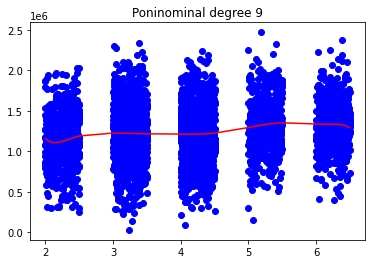

[[1.00000000e+00 4.48000000e+00 2.00704000e+01 ... 1.62264723e+05
  7.26945958e+05 3.25671789e+06]
 [1.00000000e+00 3.29000000e+00 1.08241000e+01 ... 1.37267329e+04
  4.51609513e+04 1.48579530e+05]
 [1.00000000e+00 6.20000000e+00 3.84400000e+01 ... 2.18340106e+06
  1.35370865e+07 8.39299366e+07]
 ...
 [1.00000000e+00 6.09000000e+00 3.70881000e+01 ... 1.89207497e+06
  1.15227366e+07 7.01734658e+07]
 [1.00000000e+00 3.14000000e+00 9.85960000e+00 ... 9.45011698e+03
  2.96733673e+04 9.31743734e+04]
 [1.00000000e+00 3.18000000e+00 1.01124000e+01 ... 1.04572372e+04
  3.32540144e+04 1.05747766e+05]]
(4000, 11)
---------------------------------------------------------------------------
Score r2: 0.0324080402888649
MAE: 277565.6129426494


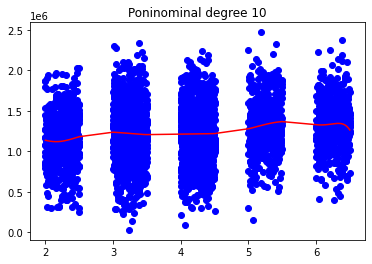

{2: 0.02597361841653567, 3: 0.026117860084385325, 4: 0.030397316436166277, 5: 0.03053608633906546, 6: 0.031594883741954294, 7: 0.031635432166517985, 8: 0.03167425498019283, 9: 0.032013108456555806, 10: 0.0324080402888649}


In [29]:
reg_poly("Avg. Area Number of Bedrooms")

In [ ]:
# Este no se estanca, va mejorando el Score con los grados que tenemos

### Area Population	

[[1.00000000e+00 1.98352473e+04 3.93437036e+08]
 [1.00000000e+00 2.13500997e+04 4.55826759e+08]
 [1.00000000e+00 3.57240185e+04 1.27620550e+09]
 ...
 [1.00000000e+00 2.08676699e+04 4.35459646e+08]
 [1.00000000e+00 4.82267189e+04 2.32581642e+09]
 [1.00000000e+00 2.82143636e+04 7.96050311e+08]]
(4000, 3)
---------------------------------------------------------------------------
Score r2: 0.17477113033550007
MAE: 254673.80154268807


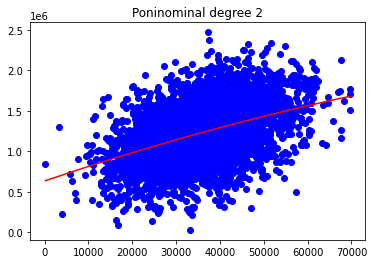

[[1.00000000e+00 1.98352473e+04 3.93437036e+08 7.80392092e+12]
 [1.00000000e+00 2.13500997e+04 4.55826759e+08 9.73194677e+12]
 [1.00000000e+00 3.57240185e+04 1.27620550e+09 4.55911888e+13]
 ...
 [1.00000000e+00 2.08676699e+04 4.35459646e+08 9.08702815e+12]
 [1.00000000e+00 4.82267189e+04 2.32581642e+09 1.12166495e+14]
 [1.00000000e+00 2.82143636e+04 7.96050311e+08 2.24600529e+13]]
(4000, 4)
---------------------------------------------------------------------------
Score r2: 0.17480211771986665
MAE: 254670.00629429307


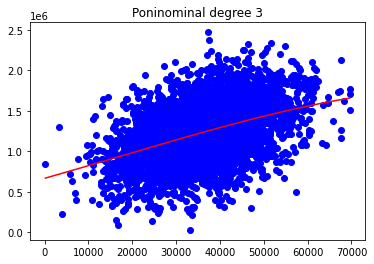

[[1.00000000e+00 1.98352473e+04 3.93437036e+08 7.80392092e+12
  1.54792701e+17]
 [1.00000000e+00 2.13500997e+04 4.55826759e+08 9.73194677e+12
  2.07778034e+17]
 [1.00000000e+00 3.57240185e+04 1.27620550e+09 4.55911888e+13
  1.62870047e+18]
 ...
 [1.00000000e+00 2.08676699e+04 4.35459646e+08 9.08702815e+12
  1.89625104e+17]
 [1.00000000e+00 4.82267189e+04 2.32581642e+09 1.12166495e+14
  5.40942201e+18]
 [1.00000000e+00 2.82143636e+04 7.96050311e+08 2.24600529e+13
  6.33696097e+17]]
(4000, 5)
---------------------------------------------------------------------------
Score r2: 0.1746813161240386
MAE: 254670.5624416194


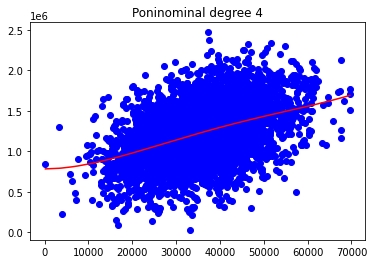

[[1.00000000e+00 1.98352473e+04 3.93437036e+08 7.80392092e+12
  1.54792701e+17 3.07035151e+21]
 [1.00000000e+00 2.13500997e+04 4.55826759e+08 9.73194677e+12
  2.07778034e+17 4.43608176e+21]
 [1.00000000e+00 3.57240185e+04 1.27620550e+09 4.55911888e+13
  1.62870047e+18 5.81837258e+22]
 ...
 [1.00000000e+00 2.08676699e+04 4.35459646e+08 9.08702815e+12
  1.89625104e+17 3.95703407e+21]
 [1.00000000e+00 4.82267189e+04 2.32581642e+09 1.12166495e+14
  5.40942201e+18 2.60878675e+23]
 [1.00000000e+00 2.82143636e+04 7.96050311e+08 2.24600529e+13
  6.33696097e+17 1.78793321e+22]]
(4000, 6)
---------------------------------------------------------------------------
Score r2: 0.17371536348093675
MAE: 254794.76597927636


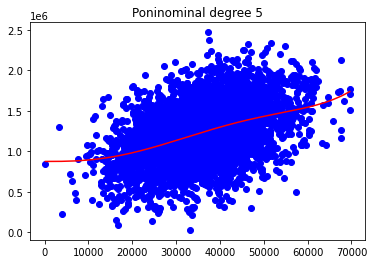

[[1.00000000e+00 1.98352473e+04 3.93437036e+08 ... 1.54792701e+17
  3.07035151e+21 6.09011816e+25]
 [1.00000000e+00 2.13500997e+04 4.55826759e+08 ... 2.07778034e+17
  4.43608176e+21 9.47107880e+25]
 [1.00000000e+00 3.57240185e+04 1.27620550e+09 ... 1.62870047e+18
  5.81837258e+22 2.07855649e+27]
 ...
 [1.00000000e+00 2.08676699e+04 4.35459646e+08 ... 1.89625104e+17
  3.95703407e+21 8.25740806e+25]
 [1.00000000e+00 4.82267189e+04 2.32581642e+09 ... 5.40942201e+18
  2.60878675e+23 1.25813225e+28]
 [1.00000000e+00 2.82143636e+04 7.96050311e+08 ... 6.33696097e+17
  1.78793321e+22 5.04453975e+26]]
(4000, 7)
---------------------------------------------------------------------------
Score r2: 0.17144075056345331
MAE: 255140.55687025923


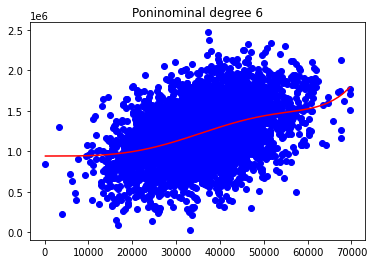

[[1.00000000e+00 1.98352473e+04 3.93437036e+08 ... 3.07035151e+21
  6.09011816e+25 1.20799000e+30]
 [1.00000000e+00 2.13500997e+04 4.55826759e+08 ... 4.43608176e+21
  9.47107880e+25 2.02208477e+30]
 [1.00000000e+00 3.57240185e+04 1.27620550e+09 ... 5.81837258e+22
  2.07855649e+27 7.42543907e+31]
 ...
 [1.00000000e+00 2.08676699e+04 4.35459646e+08 ... 3.95703407e+21
  8.25740806e+25 1.72312865e+30]
 [1.00000000e+00 4.82267189e+04 2.32581642e+09 ... 2.60878675e+23
  1.25813225e+28 6.06755905e+32]
 [1.00000000e+00 2.82143636e+04 7.96050311e+08 ... 1.78793321e+22
  5.04453975e+26 1.42328478e+31]]
(4000, 8)
---------------------------------------------------------------------------
Score r2: 0.16763500046557855
MAE: 255844.52381160043


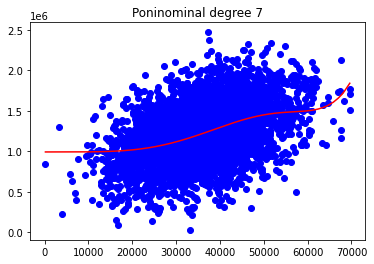

[[1.00000000e+00 1.98352473e+04 3.93437036e+08 ... 6.09011816e+25
  1.20799000e+30 2.39607804e+34]
 [1.00000000e+00 2.13500997e+04 4.55826759e+08 ... 9.47107880e+25
  2.02208477e+30 4.31717116e+34]
 [1.00000000e+00 3.57240185e+04 1.27620550e+09 ... 2.07855649e+27
  7.42543907e+31 2.65266522e+36]
 ...
 [1.00000000e+00 2.08676699e+04 4.35459646e+08 ... 8.25740806e+25
  1.72312865e+30 3.59576799e+34]
 [1.00000000e+00 4.82267189e+04 2.32581642e+09 ... 1.25813225e+28
  6.06755905e+32 2.92618465e+37]
 [1.00000000e+00 2.82143636e+04 7.96050311e+08 ... 5.04453975e+26
  1.42328478e+31 4.01570743e+35]]
(4000, 9)
---------------------------------------------------------------------------
Score r2: 0.16232224694605013
MAE: 256760.65198924477


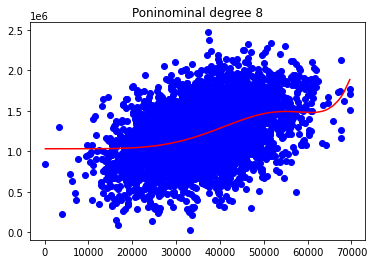

[[1.00000000e+00 1.98352473e+04 3.93437036e+08 ... 1.20799000e+30
  2.39607804e+34 4.75268005e+38]
 [1.00000000e+00 2.13500997e+04 4.55826759e+08 ... 2.02208477e+30
  4.31717116e+34 9.21720348e+38]
 [1.00000000e+00 3.57240185e+04 1.27620550e+09 ... 7.42543907e+31
  2.65266522e+36 9.47638615e+40]
 ...
 [1.00000000e+00 2.08676699e+04 4.35459646e+08 ... 1.72312865e+30
  3.59576799e+34 7.50352995e+38]
 [1.00000000e+00 4.82267189e+04 2.32581642e+09 ... 6.06755905e+32
  2.92618465e+37 1.41120285e+42]
 [1.00000000e+00 2.82143636e+04 7.96050311e+08 ... 1.42328478e+31
  4.01570743e+35 1.13300629e+40]]
(4000, 10)
---------------------------------------------------------------------------
Score r2: 0.1556883754114503
MAE: 257775.2359671772


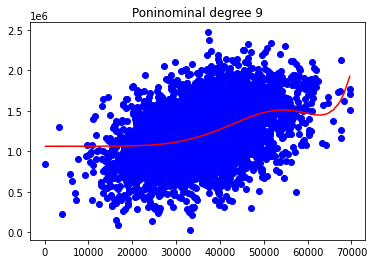

[[1.00000000e+00 1.98352473e+04 3.93437036e+08 ... 2.39607804e+34
  4.75268005e+38 9.42705843e+42]
 [1.00000000e+00 2.13500997e+04 4.55826759e+08 ... 4.31717116e+34
  9.21720348e+38 1.96788214e+43]
 [1.00000000e+00 3.57240185e+04 1.27620550e+09 ... 2.65266522e+36
  9.47638615e+40 3.38534594e+45]
 ...
 [1.00000000e+00 2.08676699e+04 4.35459646e+08 ... 3.59576799e+34
  7.50352995e+38 1.56581186e+43]
 [1.00000000e+00 4.82267189e+04 2.32581642e+09 ... 2.92618465e+37
  1.41120285e+42 6.80576831e+46]
 [1.00000000e+00 2.82143636e+04 7.96050311e+08 ... 4.01570743e+35
  1.13300629e+40 3.19670515e+44]]
(4000, 11)
---------------------------------------------------------------------------
Score r2: 0.14798787907176925
MAE: 258866.09635034853


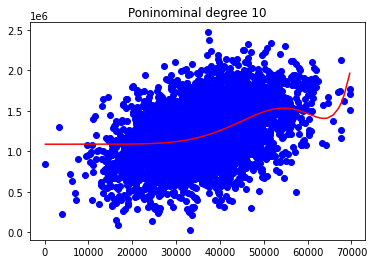

{2: 0.17477113033550007, 3: 0.17480211771986665, 4: 0.1746813161240386, 5: 0.17371536348093675, 6: 0.17144075056345331, 7: 0.16763500046557855, 8: 0.16232224694605013, 9: 0.1556883754114503, 10: 0.14798787907176925}


In [31]:
reg_poly("Area Population")

In [ ]:
# Se estanca a partir del grado 5